# GEOG0051

Mining Social and Geographic Datasets
-----------------------------------

Mobility Patterns Analysis in Cambridge
-------------------------------

Stephen Law, Igor Tkalec, Thomas Keel, and Gong Jie

For the first task, you will be analysing the mobility patterns of users from Gowalla, a now-defunct online geo-social network
from a decade ago. On Gowalla, users were able to check in at different locations across the course of the day. The dataset that
is provided to you (available on Moodle) is a subset of Gowalla users located in Cambridge, UK from the Stanford University,
Stanford Network Analysis Project. The data has been anonymised (personal identifier removed). However, you could still
trace the location of particular individuals, according to their check-in locations.
For further information, the entire dataset is available at https://snap.stanford.edu/data/loc-gowalla.html.

### 2.1 Format of Data

The variables contained in the dataset (which should be self-explanatory), provided in the `Cambridge_gowalla.csv` file, are:

* `User_ID`, or the unique identifier of the user, e.g. 196514
* `check-in-date`, e.g. 2010-07-24
* `check-in-time`, e.g. 13:45:06
* `latitude`, e.g. 53.3648119
* `longitude`, e.g. -2.2723465833
* `loc_id`, or the unique identifier of the location, e.g. 145064

### 2.2 Analysis Prompts

In [2]:
# import packages
import numpy as np
import pandas as pd
import geopandas as gpd
import random
import networkx as nx
import osmnx as ox
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import contextily as cx
import folium
import seaborn as sns
from math import radians, cos, sin, asin, sqrt

#### 2.2.0 Data pre-processing

In [3]:
## Data Loading
gowalla = pd.read_csv('Cambridge_gowalla.csv')
print(gowalla.info())
gowalla

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1871 entries, 0 to 1870
Data columns (total 7 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   ID       1871 non-null   int64  
 1   User_ID  1871 non-null   int64  
 2   date     1871 non-null   object 
 3   Time     1871 non-null   object 
 4   lon      1871 non-null   float64
 5   lat      1871 non-null   float64
 6   loc_ID   1871 non-null   int64  
dtypes: float64(2), int64(3), object(2)
memory usage: 102.4+ KB
None


,ID,User_ID,date,Time,lon,lat,loc_ID
0,1,382,12/09/2010,08:46:10,0.102380,52.173123,1307095
1,2,1050,14/08/2010,07:34:30,0.123451,52.197975,1735486
2,3,1050,14/08/2010,07:31:37,0.122774,52.197910,654162
3,4,1050,13/08/2010,21:07:46,0.116429,52.210057,516769
4,5,1050,13/08/2010,21:07:38,0.116200,52.210010,21381
...,...,...,...,...,...,...,...
1866,1867,192442,14/08/2010,17:34:26,0.127612,52.198955,31328
1867,1868,192840,30/09/2010,10:59:43,0.123349,52.203537,63552
1868,1869,192840,20/09/2010,17:14:46,0.137495,52.194409,21356
1869,1870,194926,10/07/2010,09:56:29,0.121358,52.206970,31256


In [4]:
## Data cleaning

# Missing Data: From above output, we can see that no missing values exist

# Convert date and Time to datetime type. 
datetime_str = gowalla['date'] + ' ' + gowalla['Time']
gowalla['datetime'] = pd.to_datetime(datetime_str, format='%d/%m/%Y %H:%M:%S')
gowalla['date'] = pd.to_datetime(gowalla['date'], format='%d/%m/%Y')

gowalla.head()

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10
1,2,1050,2010-08-14,07:34:30,0.123451,52.197975,1735486,2010-08-14 07:34:30
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38


In [5]:
gowalla.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1871 entries, 0 to 1870
Data columns (total 8 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   ID        1871 non-null   int64         
 1   User_ID   1871 non-null   int64         
 2   date      1871 non-null   datetime64[ns]
 3   Time      1871 non-null   object        
 4   lon       1871 non-null   float64       
 5   lat       1871 non-null   float64       
 6   loc_ID    1871 non-null   int64         
 7   datetime  1871 non-null   datetime64[ns]
dtypes: datetime64[ns](2), float64(2), int64(3), object(1)
memory usage: 117.1+ KB


In [6]:
# Duplicate Data: The same user checks in multiple times at the same location and time
counts = gowalla.groupby(['User_ID', 'loc_ID', 'datetime']).size().reset_index(name='count')
sorted_counts = counts.sort_values(by='count', ascending=False)
sorted_counts

,User_ID,loc_ID,datetime,count
0,382,1307095,2010-09-12 08:46:10,1
1243,75027,473651,2010-01-30 22:14:11,1
1255,75556,312178,2010-10-18 08:55:33,1
1254,75556,312178,2010-10-01 12:09:45,1
1253,75027,758004,2010-03-20 21:53:16,1
...,...,...,...,...
619,41075,1259071,2010-10-02 12:19:15,1
618,41075,1207152,2010-09-18 10:44:55,1
617,41075,1182253,2010-09-18 10:47:12,1
616,41075,1170764,2010-10-02 13:49:31,1


In [7]:
print(f"There are {str(gowalla['User_ID'].nunique())} unique values in the 'User_ID' variable.")
print(f"There are {str(gowalla['loc_ID'].nunique())} unique values in the 'loc_ID' variable.")

There are 191 unique values in the 'User_ID' variable.
There are 461 unique values in the 'loc_ID' variable.


In [8]:
## Data filtering: filtered out all the checkins from users whose consecutive checkins imply a speed over 1000 km/h, i.e., faster than an airplane.

# Sort the check-in date and time of each User_ID
gowalla.sort_values(['User_ID', 'datetime'], inplace=True)

gowalla.head(10)

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10
5,6,1050,2010-08-13,16:30:53,0.121358,52.206970,31256,2010-08-13 16:30:53
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37
1,2,1050,2010-08-14,07:34:30,0.123451,52.197975,1735486,2010-08-14 07:34:30
8,9,1773,2010-03-28,12:07:13,0.117668,52.205006,311333,2010-03-28 12:07:13
7,8,1773,2010-03-28,12:16:40,0.121455,52.204039,52575,2010-03-28 12:16:40
6,7,1773,2010-03-28,16:00:00,0.139358,52.202560,290570,2010-03-28 16:00:00
12,13,1876,2010-08-22,10:15:54,0.182015,52.212466,626021,2010-08-22 10:15:54


In [9]:
# Define a function in Haversine formula to calculate distance between two points given the latitude and longitude coordinates

def haversine(lat1, lon1, lat2, lon2):
    """
    Calculate the great circle distance between two points 
    on the earth (specified in decimal degrees)
    """
    # Convert decimal degrees to radians
    lat1, lon1, lat2, lon2 = map(radians, [lat1, lon1, lat2, lon2])

    # Haversine formula
    r = 6371 # Radius of earth in kilometers
    dlon = lon2 - lon1
    dlat = lat2 - lat1
    if np.abs(dlat) < 1e-8 or np.abs(dlon) < 1e-8:
        dist = 0.0
    else:
        a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
        c = 2 * asin(sqrt(a))
        dist = c*r
        
    return dist

In [10]:
# Calculate the distance between each consecutive check-in for each user

# Shift lat and lon values to calculate distance to the next location
gowalla['lat_shifted'] = gowalla.groupby('User_ID')['lat'].shift(1)
gowalla['lon_shifted'] = gowalla.groupby('User_ID')['lon'].shift(1)

# Replace lat and lon values with the first location for each User_ID
gowalla.loc[gowalla.groupby('User_ID').head(1).index, ['lat_shifted', 'lon_shifted']] = gowalla.groupby('User_ID').apply(lambda x: x.iloc[0][['lat', 'lon']]).values

# Apply haversine formula to calculate distance between locations
gowalla['dist'] = gowalla.apply(lambda row: haversine(row['lat'], row['lon'], row['lat_shifted'], row['lon_shifted']), axis=1)
gowalla.head(15)

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime,lat_shifted,lon_shifted,dist
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10,52.173123,0.102380,0.000000
5,6,1050,2010-08-13,16:30:53,0.121358,52.206970,31256,2010-08-13 16:30:53,52.206970,0.121358,0.000000
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38,52.206970,0.121358,0.487702
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46,52.210010,0.116200,0.016478
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37,52.210057,0.116429,1.418131
1,2,1050,2010-08-14,07:34:30,0.123451,52.197975,1735486,2010-08-14 07:34:30,52.197910,0.122774,0.046677
8,9,1773,2010-03-28,12:07:13,0.117668,52.205006,311333,2010-03-28 12:07:13,52.205006,0.117668,0.000000
7,8,1773,2010-03-28,12:16:40,0.121455,52.204039,52575,2010-03-28 12:16:40,52.205006,0.117668,0.279505
6,7,1773,2010-03-28,16:00:00,0.139358,52.202560,290570,2010-03-28 16:00:00,52.204039,0.121455,1.231112
12,13,1876,2010-08-22,10:15:54,0.182015,52.212466,626021,2010-08-22 10:15:54,52.212466,0.182015,0.000000


In [11]:
# Convert datetime type to Unix timestamp
gowalla['timestamp'] = gowalla['datetime'].astype('int64') / 10**9

gowalla.head()

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime,lat_shifted,lon_shifted,dist,timestamp
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10,52.173123,0.102380,0.000000,1.284281e+09
5,6,1050,2010-08-13,16:30:53,0.121358,52.206970,31256,2010-08-13 16:30:53,52.206970,0.121358,0.000000,1.281717e+09
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38,52.206970,0.121358,0.487702,1.281734e+09
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46,52.210010,0.116200,0.016478,1.281734e+09
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37,52.210057,0.116429,1.418131,1.281771e+09


In [12]:
# Calculate the time difference between each consecutive check-in for each user
gowalla['time_diff'] = gowalla.groupby('User_ID')['timestamp'].diff().fillna(0)

gowalla.head()

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime,lat_shifted,lon_shifted,dist,timestamp,time_diff
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10,52.173123,0.102380,0.000000,1.284281e+09,0.0
5,6,1050,2010-08-13,16:30:53,0.121358,52.206970,31256,2010-08-13 16:30:53,52.206970,0.121358,0.000000,1.281717e+09,0.0
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38,52.206970,0.121358,0.487702,1.281734e+09,16605.0
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46,52.210010,0.116200,0.016478,1.281734e+09,8.0
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37,52.210057,0.116429,1.418131,1.281771e+09,37431.0


In [13]:
# Convert the time difference to hours
gowalla['time_diff'] = gowalla['time_diff'] / 3600

gowalla.head(10)

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime,lat_shifted,lon_shifted,dist,timestamp,time_diff
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10,52.173123,0.102380,0.000000,1.284281e+09,0.000000
5,6,1050,2010-08-13,16:30:53,0.121358,52.206970,31256,2010-08-13 16:30:53,52.206970,0.121358,0.000000,1.281717e+09,0.000000
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38,52.206970,0.121358,0.487702,1.281734e+09,4.612500
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46,52.210010,0.116200,0.016478,1.281734e+09,0.002222
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37,52.210057,0.116429,1.418131,1.281771e+09,10.397500
1,2,1050,2010-08-14,07:34:30,0.123451,52.197975,1735486,2010-08-14 07:34:30,52.197910,0.122774,0.046677,1.281771e+09,0.048056
8,9,1773,2010-03-28,12:07:13,0.117668,52.205006,311333,2010-03-28 12:07:13,52.205006,0.117668,0.000000,1.269778e+09,0.000000
7,8,1773,2010-03-28,12:16:40,0.121455,52.204039,52575,2010-03-28 12:16:40,52.205006,0.117668,0.279505,1.269779e+09,0.157500
6,7,1773,2010-03-28,16:00:00,0.139358,52.202560,290570,2010-03-28 16:00:00,52.204039,0.121455,1.231112,1.269792e+09,3.722222
12,13,1876,2010-08-22,10:15:54,0.182015,52.212466,626021,2010-08-22 10:15:54,52.212466,0.182015,0.000000,1.282472e+09,0.000000


In [14]:
# Calculate the speed between each consecutive check-in for each user
gowalla['speed'] = gowalla['dist'] / gowalla['time_diff']

# Replace inf and NaN values with 0
gowalla['speed'] = np.where(np.logical_or(gowalla['dist']==0, gowalla['time_diff']==0), 0, gowalla['speed'])

gowalla.head()

,ID,User_ID,date,Time,lon,lat,loc_ID,datetime,lat_shifted,lon_shifted,dist,timestamp,time_diff,speed
0,1,382,2010-09-12,08:46:10,0.102380,52.173123,1307095,2010-09-12 08:46:10,52.173123,0.102380,0.000000,1.284281e+09,0.000000,0.000000
5,6,1050,2010-08-13,16:30:53,0.121358,52.206970,31256,2010-08-13 16:30:53,52.206970,0.121358,0.000000,1.281717e+09,0.000000,0.000000
4,5,1050,2010-08-13,21:07:38,0.116200,52.210010,21381,2010-08-13 21:07:38,52.206970,0.121358,0.487702,1.281734e+09,4.612500,0.105735
3,4,1050,2010-08-13,21:07:46,0.116429,52.210057,516769,2010-08-13 21:07:46,52.210010,0.116200,0.016478,1.281734e+09,0.002222,7.415308
2,3,1050,2010-08-14,07:31:37,0.122774,52.197910,654162,2010-08-14 07:31:37,52.210057,0.116429,1.418131,1.281771e+09,10.397500,0.136392


In [15]:
# find the check-ins for users whose speed is greater than 1000 km/h
ids = gowalla[gowalla['speed'] > 1000]['ID'].unique()
ids

array([], dtype=int64)

In [16]:
# Drop unwanted columns
gowalla = gowalla.drop(columns=['ID','Time','lat_shifted','lon_shifted','dist','timestamp','time_diff','speed'])

In [17]:
gowalla.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1871 entries, 0 to 1869
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   User_ID   1871 non-null   int64         
 1   date      1871 non-null   datetime64[ns]
 2   lon       1871 non-null   float64       
 3   lat       1871 non-null   float64       
 4   loc_ID    1871 non-null   int64         
 5   datetime  1871 non-null   datetime64[ns]
dtypes: datetime64[ns](2), float64(2), int64(2)
memory usage: 166.9 KB


In [18]:
# Save the cleaned dataset to a new file
# gowalla.to_csv('gowalla_cleaned.csv', index=False)

#### 2.2.1 Visualise individual check-in locations

In [19]:
## Filter check-ins information of User IDs [75027] and [102829] 
gowalla1 = gowalla.loc[gowalla['User_ID'].isin([75027, 102829])]
print(gowalla1.info())
gowalla1

<class 'pandas.core.frame.DataFrame'>
Int64Index: 142 entries, 1253 to 1355
Data columns (total 6 columns):
 #   Column    Non-Null Count  Dtype         
---  ------    --------------  -----         
 0   User_ID   142 non-null    int64         
 1   date      142 non-null    datetime64[ns]
 2   lon       142 non-null    float64       
 3   lat       142 non-null    float64       
 4   loc_ID    142 non-null    int64         
 5   datetime  142 non-null    datetime64[ns]
dtypes: datetime64[ns](2), float64(2), int64(2)
memory usage: 7.8 KB
None


,User_ID,date,lon,lat,loc_ID,datetime
1253,75027,2010-01-18,0.146594,52.209822,373382,2010-01-18 13:26:22
1252,75027,2010-01-19,0.146594,52.209822,373382,2010-01-19 09:27:38
1251,75027,2010-01-19,0.146473,52.210873,282997,2010-01-19 13:46:18
1250,75027,2010-01-19,0.146594,52.209822,373382,2010-01-19 13:50:57
1249,75027,2010-01-21,0.146594,52.209822,373382,2010-01-21 12:13:16
...,...,...,...,...,...,...
1359,102829,2010-05-26,0.110528,52.196678,963000,2010-05-26 20:56:10
1358,102829,2010-05-27,0.094001,52.212543,373983,2010-05-27 07:15:55
1357,102829,2010-05-27,0.094001,52.212543,373983,2010-05-27 14:15:14
1356,102829,2010-05-27,0.092096,52.211985,1032962,2010-05-27 14:34:21


In [20]:
print(f"User_ID [75027]'s check-ins time'：{gowalla1['User_ID'].value_counts()[75027]}")
print(f"User_ID [102829]'s check-ins time'：{gowalla1['User_ID'].value_counts()[102829]}")

User_ID [75027]'s check-ins time'：67
User_ID [102829]'s check-ins time'：75


In [21]:
user_75027 = gowalla1[gowalla1['User_ID'] == 75027]
num_distinct_loc_75027 = user_75027['loc_ID'].nunique()

user_102829 = gowalla1[gowalla1['User_ID'] == 102829]
num_distinct_loc_102829 = user_102829['loc_ID'].nunique()

In [22]:
print(f"There are {num_distinct_loc_75027} unique check-in locations of User ID [75027].")
print(f"There are {num_distinct_loc_102829} unique check-in locations of User ID [102829].")

There are 29 unique check-in locations of User ID [75027].
There are 18 unique check-in locations of User ID [102829].


In [23]:
## Visualise the check-in locations of User IDs [75027] and [102829]

## Geopandas

# Convert the data to a geopandas GeoDataFrame
geometry1 = gpd.points_from_xy(gowalla1['lon'], gowalla1['lat'])
gdf1 = gpd.GeoDataFrame(gowalla1, geometry=geometry1)

gdf1

,User_ID,date,lon,lat,loc_ID,datetime,geometry
1253,75027,2010-01-18,0.146594,52.209822,373382,2010-01-18 13:26:22,POINT (0.14659 52.20982)
1252,75027,2010-01-19,0.146594,52.209822,373382,2010-01-19 09:27:38,POINT (0.14659 52.20982)
1251,75027,2010-01-19,0.146473,52.210873,282997,2010-01-19 13:46:18,POINT (0.14647 52.21087)
1250,75027,2010-01-19,0.146594,52.209822,373382,2010-01-19 13:50:57,POINT (0.14659 52.20982)
1249,75027,2010-01-21,0.146594,52.209822,373382,2010-01-21 12:13:16,POINT (0.14659 52.20982)
...,...,...,...,...,...,...,...
1359,102829,2010-05-26,0.110528,52.196678,963000,2010-05-26 20:56:10,POINT (0.11053 52.19668)
1358,102829,2010-05-27,0.094001,52.212543,373983,2010-05-27 07:15:55,POINT (0.09400 52.21254)
1357,102829,2010-05-27,0.094001,52.212543,373983,2010-05-27 14:15:14,POINT (0.09400 52.21254)
1356,102829,2010-05-27,0.092096,52.211985,1032962,2010-05-27 14:34:21,POINT (0.09210 52.21199)


In [24]:
print(gdf1.crs)

None


In [25]:
gdf1 = gdf1.set_crs(epsg=4326)

<AxesSubplot: >

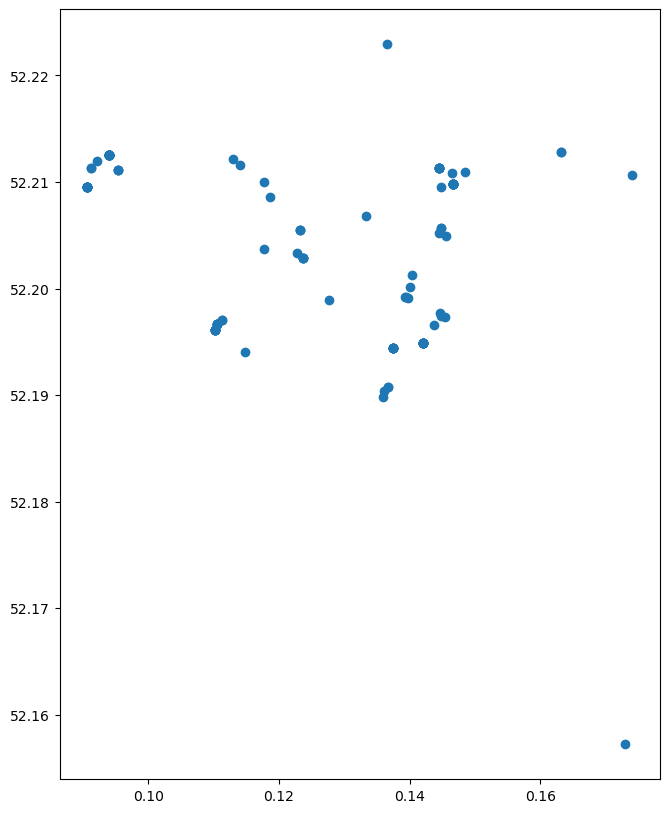

In [26]:
gdf1.plot(figsize=(10,10))

In [27]:
# Distinguishing data between two users
user1 = gdf1[gdf1['User_ID'] == 75027]
user2 = gdf1[gdf1['User_ID'] == 102829]

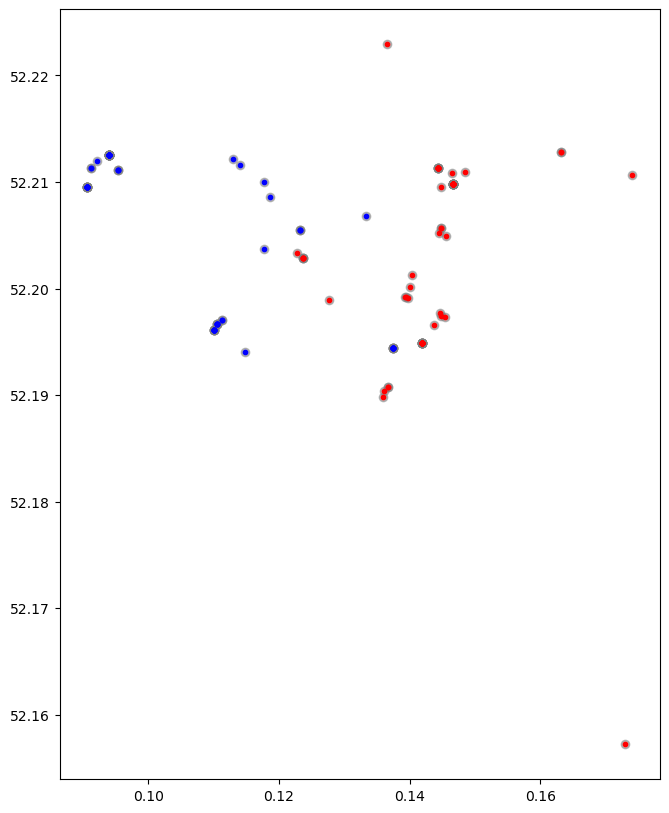

In [28]:
fig, ax = plt.subplots(figsize=(10, 10))
gdf1.plot(ax=ax, alpha=0.5, color='gray')

user1.plot(ax=ax, color='red', markersize=10)

user2.plot(ax=ax, color='blue', markersize=10)

plt.show()

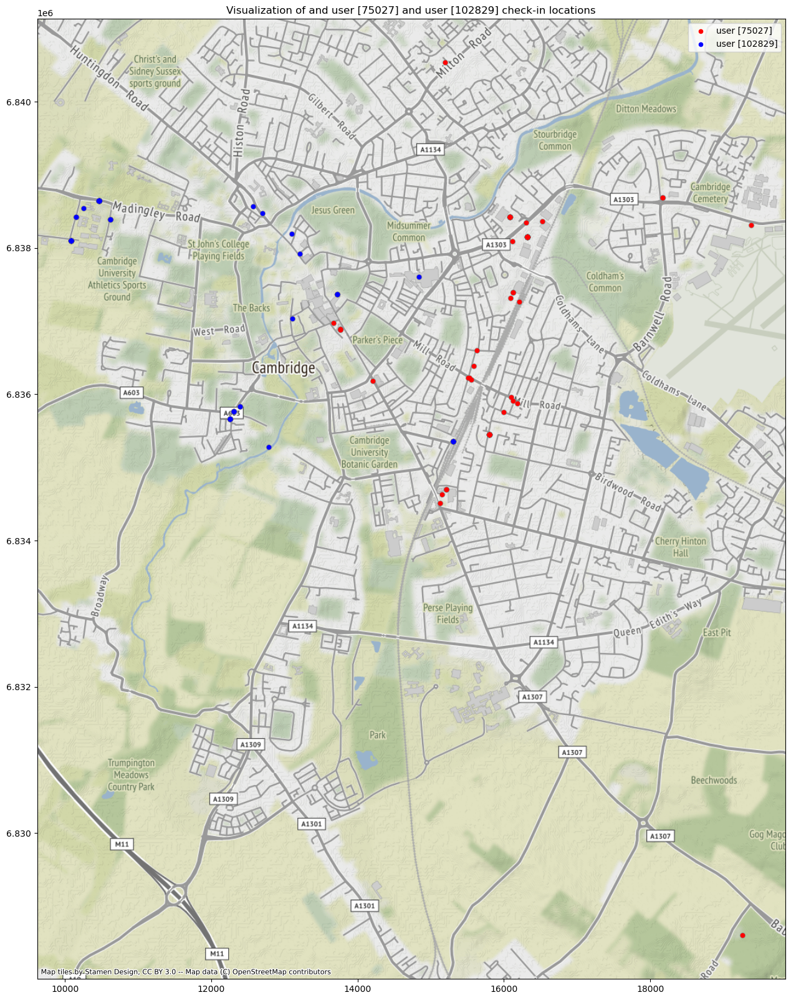

In [29]:
# Add basemap
gdf1 = gdf1.to_crs(epsg=3857)
user1 = gdf1[gdf1['User_ID'] == 75027]
user2 = gdf1[gdf1['User_ID'] == 102829]

fig, ax = plt.subplots(figsize=(20, 20))
gdf1.plot(ax=ax, alpha=0.5, color='gray')
user1.plot(ax=ax, color='red', markersize=20, label='user [75027]')
user2.plot(ax=ax, color='blue', markersize=20, label='user [102829]')

# Add a title to the plot
ax.set_title('Visualization of and user [75027] and user [102829] check-in locations')

cx.add_basemap(ax, crs=gdf1.crs.to_string())

ax.legend()
plt.show()

In [34]:
## Folium
import folium

# Create a Folium map centered on the mean latitude and longitude of the data
center_lat = gdf1['lat'].mean()
center_lon = gdf1['lon'].mean()
m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

# Add markers to the map for each check-in location of each user
for i, row in user1.iterrows():
    popup = 'User_ID: {}<br>loc_ID: {}'.format(row['User_ID'], row['loc_ID'])
    marker = folium.Marker([row['lat'], row['lon']], popup=popup, icon=folium.Icon(color='red'))
    marker.add_to(m)

for i, row in user2.iterrows():
    popup = 'User_ID: {}<br>loc_ID: {}'.format(row['User_ID'], row['loc_ID'])
    marker = folium.Marker([row['lat'], row['lon']], popup=popup, icon=folium.Icon(color='blue'))
    marker.add_to(m)

# Display the map
m

#### 2.2.2 Provide Characterisation of the Gowalla dataset

In [30]:
# Get the graph based on Cambridge in "all" network type
G = ox.graph_from_place('Cambridge,UK',network_type = 'drive')

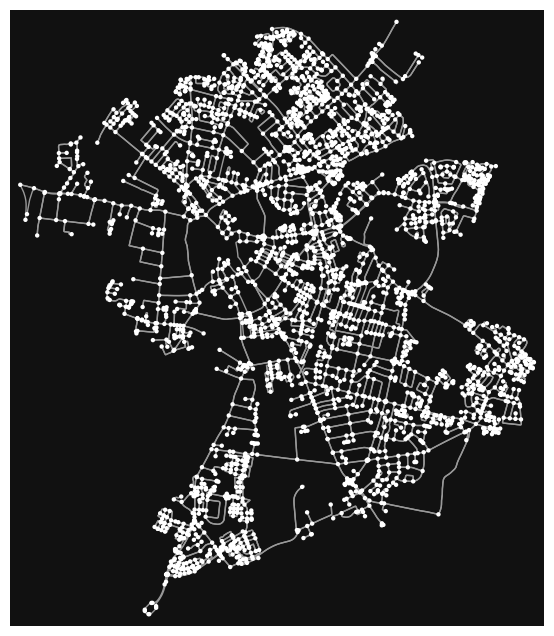

(<Figure size 800x800 with 1 Axes>, <AxesSubplot: >)

In [31]:
## Plotting street network graphs of Cambridge
ox.plot_graph(G, node_size = 10)

In [32]:
# the nodelist for the street network graph
G.nodes(data=True)

NodeDataView({104521: {'y': 52.2035497, 'x': 0.1234909, 'highway': 'traffic_signals', 'street_count': 3}, 104522: {'y': 52.2040389, 'x': 0.123043, 'street_count': 3}, 104527: {'y': 52.2084108, 'x': 0.1185074, 'street_count': 2}, 104534: {'y': 52.2073604, 'x': 0.1235208, 'street_count': 3}, 104541: {'y': 52.2091974, 'x': 0.1175301, 'highway': 'mini_roundabout', 'street_count': 3}, 104542: {'y': 52.2104012, 'x': 0.1182966, 'street_count': 4}, 104543: {'y': 52.21005, 'x': 0.1191437, 'street_count': 3}, 104549: {'y': 52.2032751, 'x': 0.1223794, 'street_count': 3}, 104550: {'y': 52.2028319, 'x': 0.1206122, 'street_count': 3}, 104551: {'y': 52.2019205, 'x': 0.1180646, 'street_count': 4}, 104552: {'y': 52.2024003, 'x': 0.1177909, 'street_count': 3}, 104554: {'y': 52.2107382, 'x': 0.1150214, 'highway': 'traffic_signals', 'street_count': 4}, 104558: {'y': 52.2105435, 'x': 0.1104122, 'highway': 'traffic_signals', 'street_count': 3}, 104570: {'y': 52.2026048, 'x': 0.1054568, 'street_count': 3}, 1

In [33]:
# the corresponding edgelist from the same graph
G.edges()

OutMultiEdgeDataView([(104521, 20823587), (104522, 104521), (104522, 6572136), (104527, 1196867225), (104534, 6572136), (104534, 6572141), (104534, 20922146), (104541, 1196867225), (104541, 104554), (104541, 104542), (104542, 104543), (104542, 20921841), (104542, 20921841), (104542, 104541), (104543, 20921842), (104543, 20921850), (104543, 104542), (104549, 1547164562), (104549, 20921971), (104550, 609752), (104550, 20922086), (104551, 18058677), (104551, 20922037), (104551, 20921995), (104551, 1572750226), (104552, 20921995), (104552, 20921976), (104552, 20922002), (104554, 20940095), (104554, 104541), (104554, 20940098), (104554, 18951464), (104558, 6572035), (104558, 6572031), (104558, 20963086), (104570, 20962879), (104570, 20963168), (104570, 104571), (104571, 104572), (104571, 104570), (104571, 6572035), (104572, 104573), (104572, 1488979824), (104572, 20962874), (104572, 104571), (104573, 104572), (104576, 20963168), (104576, 20962937), (104576, 20963213), (104581, 5313641), (10

In [34]:
print(gdf1.crs)

EPSG:3857


In [35]:
## Calculating and displaying the shortest path

# Check check-in records of user [75027] on 30/01/2010 and user [102829] on 24/05/2010
user1 = gowalla[(gowalla['User_ID'] == 75027) & (gowalla['date'] == '2010-01-30')]
user2 = gowalla[(gowalla['User_ID'] == 102829) & (gowalla['date'] == '2010-05-24')]

In [36]:
type(user1)

pandas.core.frame.DataFrame

In [37]:
user1

,User_ID,date,lon,lat,loc_ID,datetime
1227,75027,2010-01-30,0.173005,52.157223,477840,2010-01-30 15:13:43
1226,75027,2010-01-30,0.145606,52.204923,31968,2010-01-30 16:04:04
1225,75027,2010-01-30,0.144522,52.205200,478133,2010-01-30 16:06:57
1224,75027,2010-01-30,0.144826,52.205650,478191,2010-01-30 16:15:35
1223,75027,2010-01-30,0.146594,52.209822,373382,2010-01-30 16:59:45
1222,75027,2010-01-30,0.144786,52.209487,159331,2010-01-30 17:05:41
1221,75027,2010-01-30,0.144424,52.211325,374196,2010-01-30 17:20:55
1220,75027,2010-01-30,0.127612,52.198955,31328,2010-01-30 21:27:50
1219,75027,2010-01-30,0.123643,52.202858,473651,2010-01-30 22:14:11


In [38]:
user2

,User_ID,date,lon,lat,loc_ID,datetime
1375,102829,2010-05-24,0.137495,52.194409,21356,2010-05-24 10:58:54
1374,102829,2010-05-24,0.090578,52.209531,536286,2010-05-24 12:14:26
1373,102829,2010-05-24,0.094001,52.212543,373983,2010-05-24 14:20:06
1372,102829,2010-05-24,0.114811,52.194001,1166464,2010-05-24 17:16:12
1371,102829,2010-05-24,0.117766,52.203666,21357,2010-05-24 17:33:12
1370,102829,2010-05-24,0.117664,52.210026,558662,2010-05-24 17:49:04
1369,102829,2010-05-24,0.118662,52.208558,21375,2010-05-24 18:46:53
1368,102829,2010-05-24,0.110121,52.196113,1024097,2010-05-24 20:34:44


In [40]:
print(f"User_ID [75027]'s check-ins time on 30/01/2010 '：{user1['User_ID'].value_counts()}")
print(f"User_ID [102829]'s check-ins time on 24/05/2010'：{user2['User_ID'].value_counts()}")
print(f"There are {user1['loc_ID'].nunique()} unique check-in locations of User ID [75027].")
print(f"There are {user2['loc_ID'].nunique()} unique check-in locations of User ID [102829].")

User_ID [75027]'s check-ins time on 30/01/2010 '：75027    9
Name: User_ID, dtype: int64
User_ID [102829]'s check-ins time on 24/05/2010'：102829    8
Name: User_ID, dtype: int64
There are 9 unique check-in locations of User ID [75027].
There are 8 unique check-in locations of User ID [102829].


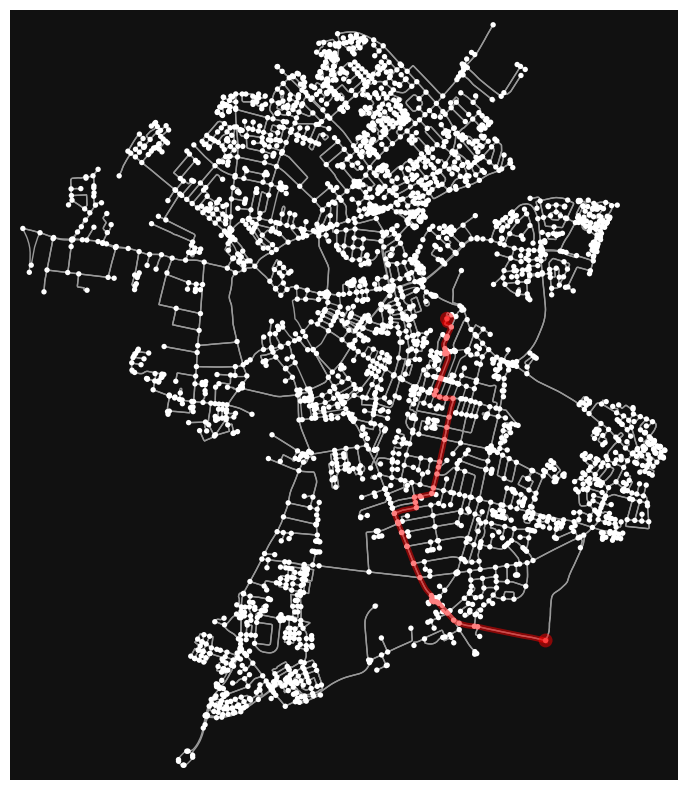

In [44]:
# user [75027] on 30/01/2010 from 15:13:43 to 16:04:04
# define origin/desination points then get the nodes nearest to each
origin_point = [52.157223, 0.173005] 
destination_point = [52.204923, 0.145606] 
origin_node = ox.nearest_nodes(G, origin_point[1],origin_point[0]) #  origin_point[1],origin_point[0] refer to longitude and latitude coordinates
destination_node = ox.nearest_nodes(G, destination_point[1],destination_point[0]) # Convert longitude and latitude to the closest node on the network
origin_node, destination_node 

# find the shortest path between origin and destination nodes
route = nx.shortest_path(G, origin_node, destination_node, weight='length')
str(route)

# plot the route showing origin/destination lat-long points in red
fig,ax = ox.plot_graph_route(G, route,figsize=(10,10))

In [45]:
type(route)

list

In [46]:
print(origin_node)
print(destination_node)

20922527
1513021086


In [47]:
# Convert longitude and latitude to the nearest node on the network

def calculate_nearest_node(df, G):
    '''
    Calculates the nearest network node for each check-in location based on the 'lat' and 'lon' columns.
    
    Parameters:
    -----------
    df : pandas.DataFrame
        The input DataFrame containing lat,lon columns.
    G : networkx.MultiDiGraph
        The input network graph from osmnx.
    
    Returns:
    --------
    df : pandas.DataFrame
        The input DataFrame with a new 'node' column containing the nearest network node for each check-in record.
    '''
    # Create an empty column to store the node IDs
    df['node'] = pd.Series(dtype='Int64')
    
    # Loop through each row of the DataFrame and calculate the nearest network node
    for i, row in df.iterrows():
        # Get the lat,lon coordinates of the current row
        point = (row['lat'], row['lon'])
        
        # Calculate the nearest network node using osmnx
        node = ox.nearest_nodes(G, point[1], point[0], return_dist=False)
        
        # Store the result in the 'node' column
        df.at[i, 'node'] = node
    
    return df

In [48]:
user1 = calculate_nearest_node(user1, G)
user1

C:\Users\lls\AppData\Local\Temp\ipykernel_36488\1939317877.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['node'] = pd.Series(dtype='Int64')


,User_ID,date,lon,lat,loc_ID,datetime,node
1227,75027,2010-01-30,0.173005,52.157223,477840,2010-01-30 15:13:43,20922527
1226,75027,2010-01-30,0.145606,52.204923,31968,2010-01-30 16:04:04,1513021086
1225,75027,2010-01-30,0.144522,52.205200,478133,2010-01-30 16:06:57,20826606
1224,75027,2010-01-30,0.144826,52.205650,478191,2010-01-30 16:15:35,1513021086
1223,75027,2010-01-30,0.146594,52.209822,373382,2010-01-30 16:59:45,19851203
1222,75027,2010-01-30,0.144786,52.209487,159331,2010-01-30 17:05:41,608910
1221,75027,2010-01-30,0.144424,52.211325,374196,2010-01-30 17:20:55,19851244
1220,75027,2010-01-30,0.127612,52.198955,31328,2010-01-30 21:27:50,609064
1219,75027,2010-01-30,0.123643,52.202858,473651,2010-01-30 22:14:11,104521


In [49]:
user2 = calculate_nearest_node(user2, G)
user2

C:\Users\lls\AppData\Local\Temp\ipykernel_36488\1939317877.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['node'] = pd.Series(dtype='Int64')


,User_ID,date,lon,lat,loc_ID,datetime,node
1375,102829,2010-05-24,0.137495,52.194409,21356,2010-05-24 10:58:54,3771203900
1374,102829,2010-05-24,0.090578,52.209531,536286,2010-05-24 12:14:26,24654319
1373,102829,2010-05-24,0.094001,52.212543,373983,2010-05-24 14:20:06,104584
1372,102829,2010-05-24,0.114811,52.194001,1166464,2010-05-24 17:16:12,20962822
1371,102829,2010-05-24,0.117766,52.203666,21357,2010-05-24 17:33:12,20921976
1370,102829,2010-05-24,0.117664,52.210026,558662,2010-05-24 17:49:04,104542
1369,102829,2010-05-24,0.118662,52.208558,21375,2010-05-24 18:46:53,1196867225
1368,102829,2010-05-24,0.110121,52.196113,1024097,2010-05-24 20:34:44,20962781


In [50]:
# Find the shortest path between each consecutive stop-points

def find_shortest_path(df, G):
    '''
    Find the shortest path between each consecutive stop-points based on the 'node' column.
    '''
    # Create a list to store all the shortest paths between consecutive stop-points
    shortest_paths = []
    
    # Create a list to store the lengths of each path
    path_lengths = [0] * (len(df))
    
    # Loop over each consecutive stop-point
    for i in range(len(df) - 1):
        # Get the origin and destination nodes for stop-points in adjacent time points
        origin_node = df['node'].iloc[i]
        destination_node = df['node'].iloc[i+1]
        
        # Find the shortest path between the two nodes and add the route to the list of shortest paths
        route = nx.shortest_path(G, origin_node, destination_node, weight='length')
        shortest_paths.append(route)
        
        # Calculate the length of the path and add it to the list
        path_length = nx.shortest_path_length(G, origin_node, destination_node, weight='length')
        path_lengths[i+1] = path_length
    
    # generate a list of random colors with the same length (same origin and destination) as shortest_paths 
    rc = ['#' + ''.join(random.choices('0123456789ABCDEF', k=6)) for _ in range(len(shortest_paths))] # colors for each route

    # plot all the routes together on the same map
    ax = ox.plot_graph_routes(G, shortest_paths, route_colors=rc, route_linewidth=1, node_size=0,figsize=(10,10))
    
    # add the path lengths to the user's dataset
    df['path_length'] = path_lengths
    
    # return the list of shortest paths
    return shortest_paths

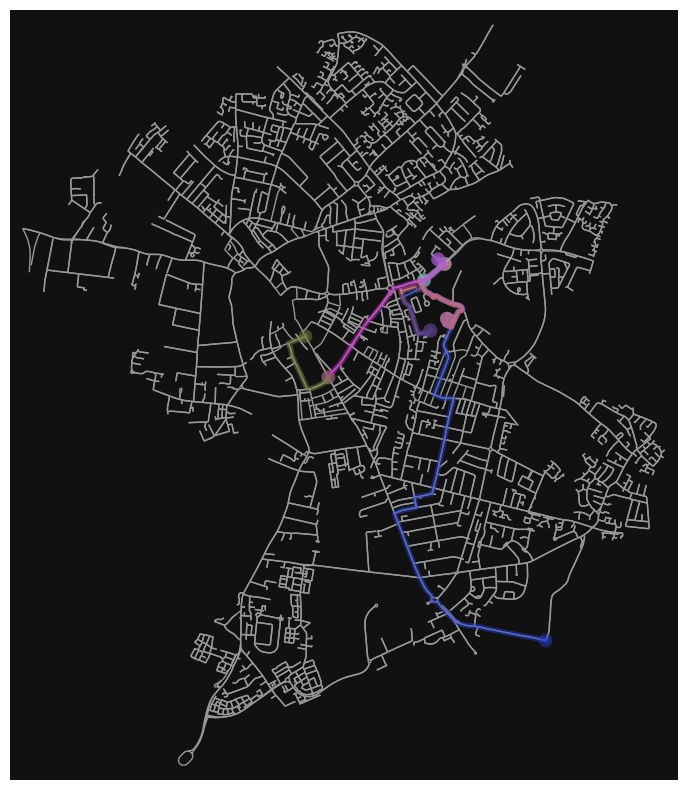

C:\Users\lls\AppData\Local\Temp\ipykernel_36488\640515604.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['path_length'] = path_lengths


[[20922527,
  25288280,
  20922531,
  443903540,
  554263,
  673845809,
  554283,
  554272,
  482307363,
  482307373,
  554269,
  725608491,
  5457750027,
  554294,
  8085920,
  1486045382,
  1486034654,
  1486034699,
  1486034710,
  20922506,
  25288228,
  20922508,
  4788674901,
  1874306954,
  1485960862,
  14913672,
  20947749,
  19287470,
  18382663,
  24670769,
  6572126,
  1573048383,
  10019546547,
  1573048384,
  1573048391,
  1573048392,
  1573048402,
  20458686,
  20458767,
  20458766,
  20458774,
  20458775,
  20458658,
  574887373,
  20458651,
  98936372,
  1513021086],
 [1513021086,
  98936372,
  2580731394,
  18650273,
  18650274,
  2179905293,
  705448024,
  526297006,
  1572499284,
  16713913,
  19851346,
  20826574,
  20826570,
  20826563,
  527446635,
  1480048755,
  20826576,
  20826577,
  19851527,
  14913698,
  20826601,
  20826606],
 [20826606,
  20826601,
  14913698,
  19851527,
  20826577,
  20826576,
  1480048755,
  20826569,
  20826570,
  20826574,
  19851346

In [52]:
find_shortest_path(user1, G)

In [53]:
user1

,User_ID,date,lon,lat,loc_ID,datetime,node,path_length
1227,75027,2010-01-30,0.173005,52.157223,477840,2010-01-30 15:13:43,20922527,0.000
1226,75027,2010-01-30,0.145606,52.204923,31968,2010-01-30 16:04:04,1513021086,5436.019
1225,75027,2010-01-30,0.144522,52.205200,478133,2010-01-30 16:06:57,20826606,1909.047
1224,75027,2010-01-30,0.144826,52.205650,478191,2010-01-30 16:15:35,1513021086,1833.497
1223,75027,2010-01-30,0.146594,52.209822,373382,2010-01-30 16:59:45,19851203,1373.382
1222,75027,2010-01-30,0.144786,52.209487,159331,2010-01-30 17:05:41,608910,303.175
1221,75027,2010-01-30,0.144424,52.211325,374196,2010-01-30 17:20:55,19851244,402.351
1220,75027,2010-01-30,0.127612,52.198955,31328,2010-01-30 21:27:50,609064,2025.003
1219,75027,2010-01-30,0.123643,52.202858,473651,2010-01-30 22:14:11,104521,1069.022


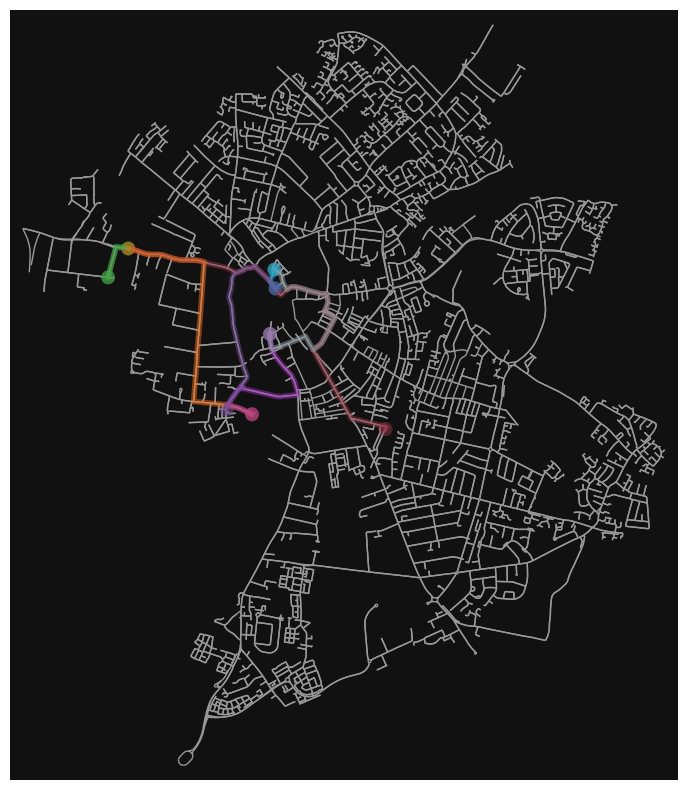

C:\Users\lls\AppData\Local\Temp\ipykernel_36488\640515604.py:34: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['path_length'] = path_lengths


[[3771203900,
  2063015294,
  582086000,
  6572104,
  583289861,
  1479444517,
  1479444521,
  4089043033,
  8972232330,
  8389140413,
  1244720067,
  6572081,
  21390893,
  6572082,
  21390892,
  25285201,
  25285200,
  21390891,
  21524596,
  21390890,
  554299,
  609064,
  14959440,
  14913681,
  237958307,
  237958302,
  14913689,
  14913690,
  20823845,
  20823597,
  14959448,
  1488953759,
  4500407729,
  1760718449,
  560570584,
  20823667,
  20922147,
  6572141,
  6572143,
  6572145,
  6572151,
  104527,
  1196867225,
  104541,
  104554,
  20940095,
  6572035,
  104558,
  20963086,
  104581,
  5313641,
  104582,
  104583,
  20963171,
  104584,
  104585,
  24654319],
 [24654319, 104585, 1489153098, 1489153055, 104584],
 [104584,
  20963171,
  104583,
  104582,
  5313641,
  104581,
  20963086,
  20962937,
  104576,
  20963168,
  104570,
  20962879,
  20963053,
  20963137,
  20963255,
  20962957,
  20963229,
  20963341,
  20963153,
  20962924,
  20963035,
  15431272,
  20962822],


In [55]:
find_shortest_path(user2, G)

In [56]:
user2

,User_ID,date,lon,lat,loc_ID,datetime,node,path_length
1375,102829,2010-05-24,0.137495,52.194409,21356,2010-05-24 10:58:54,3771203900,0.000
1374,102829,2010-05-24,0.090578,52.209531,536286,2010-05-24 12:14:26,24654319,5147.821
1373,102829,2010-05-24,0.094001,52.212543,373983,2010-05-24 14:20:06,104584,503.775
1372,102829,2010-05-24,0.114811,52.194001,1166464,2010-05-24 17:16:12,20962822,3172.774
1371,102829,2010-05-24,0.117766,52.203666,21357,2010-05-24 17:33:12,20921976,2049.294
1370,102829,2010-05-24,0.117664,52.210026,558662,2010-05-24 17:49:04,104542,2316.455
1369,102829,2010-05-24,0.118662,52.208558,21375,2010-05-24 18:46:53,1196867225,250.263
1368,102829,2010-05-24,0.110121,52.196113,1024097,2010-05-24 20:34:44,20962781,2290.002


In [57]:
print(f"User_ID [75027]'s maximum displacement：{user1['path_length'].max()}")
print(f"User_ID [102829]'s maximum displacement：{user2['path_length'].max()}")

print(f"User_ID [75027]'s average displacement：{user1['path_length'].mean()}")
print(f"User_ID [102829]'s average displacement：{user2['path_length'].mean()}")

print(f"User_ID [75027]'s total distance travelled on the day：{user1['path_length'].sum()}")
print(f"User_ID [102829]'s total distance travelled on the day：{user2['path_length'].sum()}")

User_ID [75027]'s maximum displacement：5436.018999999999
User_ID [102829]'s maximum displacement：5147.820999999999
User_ID [75027]'s average displacement：1594.6106666666665
User_ID [102829]'s average displacement：1966.2979999999998
User_ID [75027]'s total distance travelled on the day：14351.496
User_ID [102829]'s total distance travelled on the day：15730.383999999998


#### 2.2.3 Comparative analysis of check-in frequencies and network centrality

In [88]:
## Check-in frequencies
# Calculate the number of check-in times for each location ID
checkin_counts = gowalla['loc_ID'].value_counts()

location_df = pd.DataFrame({'checkin_counts': checkin_counts}, index=checkin_counts.index)
location_df = location_df.join(gowalla.set_index('loc_ID')[['lat', 'lon']].drop_duplicates())

location_df.head()

,checkin_counts,lat,lon
21356,115,52.194409,0.137495
373983,68,52.212543,0.094001
52575,45,52.204039,0.121455
40283,44,52.211312,0.091172
89095,36,52.235110,0.153274


In [89]:
# Convert the data to a geopandas GeoDataFrame
geometry2 = gpd.points_from_xy(location_df['lon'], location_df['lat'])
gdf2 = gpd.GeoDataFrame(location_df, geometry=geometry2)

print(gdf2.crs)
gdf2.head()

None


,checkin_counts,lat,lon,geometry
21356,115,52.194409,0.137495,POINT (0.13750 52.19441)
373983,68,52.212543,0.094001,POINT (0.09400 52.21254)
52575,45,52.204039,0.121455,POINT (0.12145 52.20404)
40283,44,52.211312,0.091172,POINT (0.09117 52.21131)
89095,36,52.235110,0.153274,POINT (0.15327 52.23511)


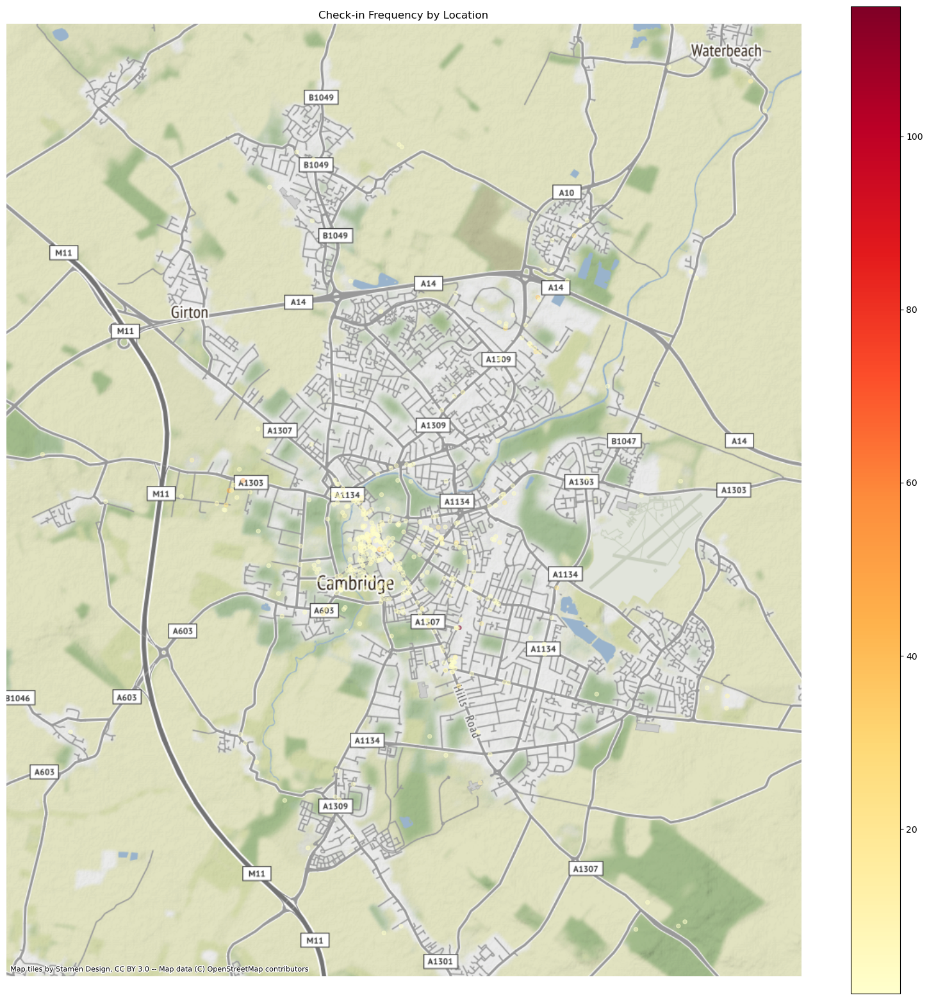

In [90]:
gdf2 = gdf2.set_crs(epsg=4326)
gdf2 = gdf2.to_crs(epsg=3857)

# Create a Matplotlib figure and axis object
fig, ax = plt.subplots(figsize=(20, 20))

# Plot the points and map the color to check-in counts
gdf2.plot(column='checkin_counts', cmap='YlOrRd', markersize=20,alpha=0.5, ax=ax, legend=True)

# Add a title to the plot
ax.set_title('Check-in Frequency by Location')

# add a basemap using contextilly
cx.add_basemap(ax, crs=gdf2.crs.to_string())
plt.axis('off')
plt.show()


In [91]:
## Closeness centrality
# first set as diGraph
DG = ox.get_digraph(G)

In [92]:
# calculate the closeness centrality: convert graph into a line graph so edges become nodes and vice versa
edge_cc = nx.closeness_centrality(nx.line_graph(DG))
print(edge_cc)

# set the attributes back to its edge
nx.set_edge_attributes(DG, edge_cc,'cc')

# turn back to multiGraph for plotting
G1 = nx.MultiGraph(DG)

{(104521, 20823587): 0.029599888642543554, (20823587, 14959440): 0.031465967717471094, (104522, 104521): 0.03009846015238271, (104522, 6572136): 0.030100001561836613, (6572136, 104534): 0.031130424058509083, (6572136, 6572143): 0.031130698866830536, (104527, 1196867225): 0.030405196713187622, (1196867225, 6572150): 0.030783946201079788, (1196867225, 104541): 0.030783543122121518, (1196867225, 104527): 0.030783543122121518, (104534, 6572136): 0.03095268346894636, (104534, 6572141): 0.03095268346894636, (6572141, 6572143): 0.030785961754218688, (6572141, 20922147): 0.030785961754218688, (6572141, 104534): 0.030785961754218688, (104534, 20922146): 0.03095268346894636, (20922146, 20922147): 0.030471534273306174, (20922146, 14959451): 0.030471534273306174, (20922146, 104534): 0.030471534273306174, (104541, 1196867225): 0.031212670339643988, (104541, 104554): 0.031212670339643988, (104554, 20940095): 0.03177486063742519, (104554, 104541): 0.03177486063742519, (104554, 20940098): 0.0317748606

C:\Users\lls\AppData\Local\Temp\ipykernel_36488\2960750741.py:15: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm)


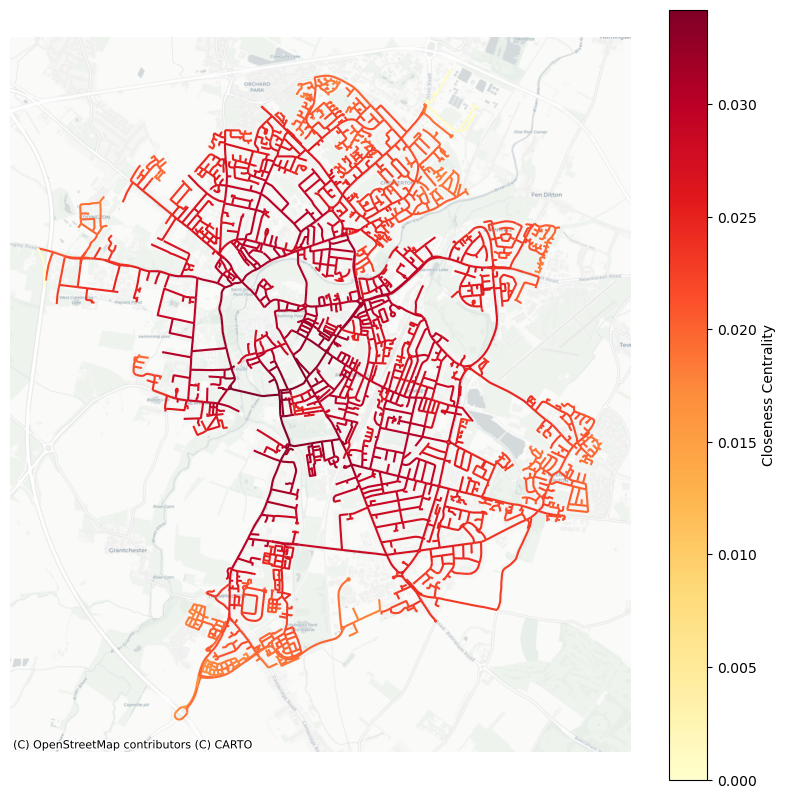

In [93]:
import matplotlib.cm as cm

# convert graph to geopandas dataframe
gdf_edges = ox.graph_to_gdfs(G1,nodes=False,fill_edge_geometry=True)

# set crs to 3857 (needed for contextily)
gdf_edges = gdf_edges.to_crs(epsg=3857) # setting crs to 3857

# plot edges according to closeness centrality
ax=gdf_edges.plot('cc',cmap='YlOrRd',figsize=(10,10))

# add colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=gdf_edges.cc.min(), vmax=gdf_edges.cc.max()))
sm._A = []
cbar = plt.colorbar(sm)
cbar.set_label('Closeness Centrality')

# add a basemap using contextilly
cx.add_basemap(ax,source=cx.providers.CartoDB.Positron)
plt.axis('off')
plt.show()


C:\Users\lls\AppData\Local\Temp\ipykernel_36488\3119152591.py:15: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  cbar = plt.colorbar(sm)


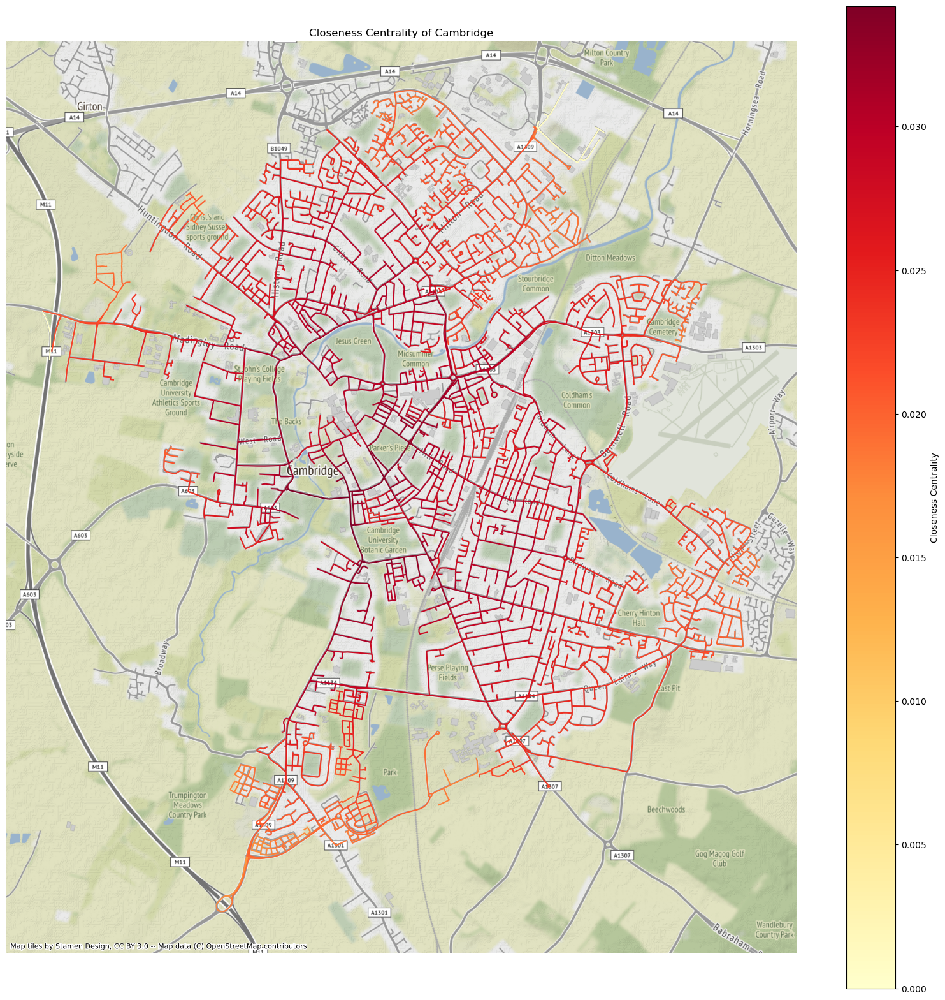

In [94]:
# Change another basemap

# convert graph to geopandas dataframe
gdf_edges = ox.graph_to_gdfs(G1,nodes=False,fill_edge_geometry=True)

# set crs to 3857 (needed for contextily)
gdf_edges = gdf_edges.to_crs(epsg=3857) # setting crs to 3857

# plot edges according to closeness centrality
ax=gdf_edges.plot('cc',cmap='YlOrRd',figsize=(20,20))

# add colorbar
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=gdf_edges.cc.min(), vmax=gdf_edges.cc.max()))
sm._A = []
cbar = plt.colorbar(sm)
cbar.set_label('Closeness Centrality')

# add a title to the plot
ax.set_title('Closeness Centrality of Cambridge')

# add a basemap using contextilly
cx.add_basemap(ax, crs=gdf1.crs.to_string())
plt.axis('off')
plt.show()

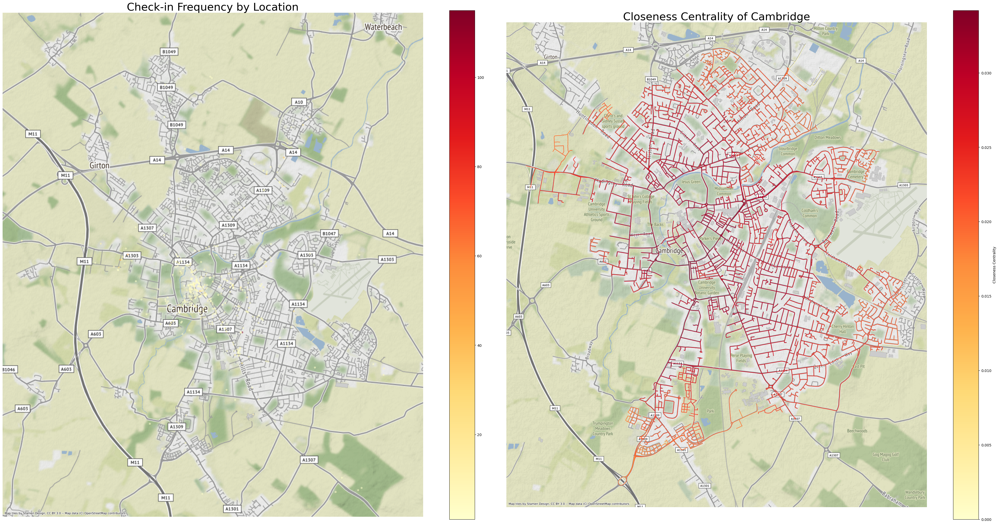

In [96]:
# multiple sub-figures
fig, axs = plt.subplots(1, 2, figsize=(40, 20))

# Plot the first subplot - Check-in Frequency by Location
gdf2.plot(column='checkin_counts', cmap='YlOrRd', markersize=20, alpha=0.5, ax=axs[0], legend=True)
axs[0].set_title('Check-in Frequency by Location',fontdict={'fontsize': 30})
cx.add_basemap(axs[0], crs=gdf2.crs.to_string())
axs[0].axis('off')

# Plot the second subplot - Closeness Centrality of Cambridge
gdf_edges.plot('cc', cmap='YlOrRd', figsize=(20, 20), ax=axs[1])
sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=gdf_edges.cc.min(), vmax=gdf_edges.cc.max()))
sm._A = []
cbar = plt.colorbar(sm, ax=axs[1])
cbar.set_label('Closeness Centrality')
axs[1].set_title('Closeness Centrality of Cambridge',fontdict={'fontsize': 30})
cx.add_basemap(axs[1], crs=gdf1.crs.to_string())
axs[1].axis('off')

# adjust the layout and display the plot
plt.tight_layout()
plt.show()


#### 2.2.4 Urban Planning Application Question